In [1]:
import os

# Specify the below path to "Data_augmentation_Mosaic_Albumentations_Yolo" folder
path = 'your_path_to/Data_augmentation_Mosaic_Albumentations_Yolo'
os.chdir(path)

In [2]:
! pip3 install -r requirements.txt

In [3]:
%matplotlib inline

import glob
import numpy as np
import matplotlib.pyplot as plt
import cv2

# Helper functions & Setting up

In [4]:
def img_to_arr(img_folder):
  """Load all images as arrays from a folder & save them into a list"""
  img_arrs = list()

  # make sure there's a slash to the folder path 
  img_folder += "" if img_folder[-1] == "/" else "/"
  # get all text files
  img_files = glob.glob(img_folder + "*.jpg")

  for img_f in img_files:
    # Load the images
    img_arr = cv2.imread(img_f, cv2.IMREAD_COLOR)
    img_arr = cv2.cvtColor(img_arr, cv2.COLOR_RGB2BGR)
    img_arrs.append(img_arr)
  return np.array(img_arrs)

In [5]:
def anno_to_arr(txt_folder):
  """Load all annotation txt file as list of boxes & save them into a list"""
  txt_arrs = list()

  # make sure there's a slash to the folder path 
  txt_folder += "" if txt_folder[-1] == "/" else "/"
  txt_files = glob.glob(txt_folder + "*.txt")

  for txt_f in txt_files:
    boxes_f = list()  # List of all annotations in an image
    with open(txt_f, 'r') as fd:
      lines = fd.readlines()
      for line in lines:
        box = np.array([None]*5)
        line = line.strip().split(' ')
        box[0] = float(line[0])  # label
        box[1] = float(line[1])
        box[2] = float(line[2])
        box[3] = float(line[3])
        box[4] = float(line[4])
        boxes_f.append(box)
    
    # Append all annotations of an image
    txt_arrs.append(np.array(boxes_f))
  return np.array(txt_arrs)

In [6]:
def yolo_to_pascal(x, y, w, h, width, height):
  xmax = int((x*width) + (w * width)/2.0)
  xmin = int((x*width) - (w * width)/2.0)
  ymax = int((y*height) + (h * height)/2.0)
  ymin = int((y*height) - (h * height)/2.0)
  return xmin, ymin, xmax, ymax

# Albumentation library visualization

In [7]:
import pandas as pd
import numpy as np
import cv2

import albumentations as A
from torch.utils.data import DataLoader, Dataset
from matplotlib import pyplot as plt

DIR_DATA = './dataset/images'

In [8]:
df = pd.read_csv('./dataset/data_csv.csv', index_col=False)
df.head()

,image_id,width,height,label,x,y,w,h
0,1,960,960,0,0.493359,0.567361,0.063281,0.095833
1,1,960,960,0,0.886328,0.877083,0.049219,0.126389
2,3,960,960,0,0.561719,0.361806,0.021875,0.079167
3,3,960,960,0,0.218750,0.483333,0.045312,0.091667
4,4,960,960,1,0.183594,0.563194,0.056250,0.098611


# Dataset construction

In [9]:
from sklearn.utils import shuffle
import random

class FPTDataset(Dataset):
  def __init__(self, dataframe, image_dir, transforms=None):
    super().__init__()

    self.df = dataframe  # Annotation & Image's ID dataframe
    self.transforms = transforms  # Albumentation's augmentation
    self.image_ids = shuffle(dataframe['image_id'].unique())  # Image's ID
    self.labels = [np.zeros((0, 4), dtype=np.float32)] * len(self.image_ids) # Image's bboxes
    self.class_labels = [np.zeros((0, 1), dtype=np.float32)] * len(self.image_ids)  # Image's label
    self.img_size = 960
    self.image_dir = image_dir
    im_w = 1280
    im_h = 720

    # Loop through each image (Each image might containt multiple bboxes & labels)
    for i, img_id in enumerate(self.image_ids):
      records = self.df[self.df['image_id'] == img_id]
      boxes = records[['x', 'y', 'w', 'h']].values  # Annotations
      class_label = records[['label']].values
      self.labels[i] = np.array(boxes)
      self.class_labels[i] = class_label

  def __getitem__(self, index: int):
    # DATA AUGMENTATION
    if self.transforms is not None:
      # Load image
      image, (h0, w0) = load_image(self, index)

      # Augmentation
      augmented = self.transforms(image=image, bboxes=self.labels[index], class_labels=self.class_labels[index])
      image = augmented['image']
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # BGR to RGB
      bboxes = augmented['bboxes']
      labels = augmented['class_labels']

      return image, bboxes, labels

  def __len__(self) -> int:
    return self.image_ids.shape[0]

def load_image(self, index):
  # loads 1 image from dataset, returns img, original hw, resized hw
  """Load 1 image from dataset
  Input:
    index: idx to search for image's id
  Output:
    img, hw_original, hw_resized """
  # Read an image using opencv2
  image_id = self.image_ids[index]
  imgpath = f'{self.image_dir}/{image_id}.jpg'
  img = cv2.imread(imgpath, cv2.IMREAD_COLOR)
    
  assert img is not None, 'Image Not Found ' + imgpath
  h0, w0 = img.shape[:2]  # orig hw
  return img, (h0, w0)  # img, hw_original

# Visualize Albumentation library

In [17]:
def collate_fn(batch):
    return tuple(zip(*batch))

def aug_visualize(train_val_df, train_val_dir, transform, batch_size, type_aug=None):
  train_dataset = FPTDataset(train_val_df, train_val_dir, transform)  # 792 images
  train_data_loader = DataLoader(
      train_dataset,
      batch_size=batch_size,
      shuffle=True,
      num_workers=4,
      collate_fn=collate_fn
  )
  fig, ax = plt.subplots(2, 4, figsize=(20, 10))
  ax = ax.flatten()
  images, targets, class_labels = next(iter(train_data_loader))

  for i in range(8):  # Go through each batch 
    boxes = targets[i]
    sample = images[i]
    height, width = sample.shape[:2]

    for box in boxes:
      # Convert from Yolo to Pascal_voc
      box = yolo_to_pascal(box[0], box[1], box[2], box[3], width, height)
      # Drawing bounding box
      cv2.rectangle(sample,
                (int(box[0]), int(box[1])),
                (int(box[2]), int(box[3])),
                220, 3)

    ax[i].axis('off')
    ax[i].imshow(sample)  # Visualize a sample for each batch
  plt.subplots_adjust(left=0, right=0.9, bottom=0, top=0.9, wspace=-0.2, hspace=0.05)
  if type_aug is not None:
    plt.savefig(f'./others/{type_aug}.png', dpi=300, bbox_inches='tight')
  plt.show()

## channelDropout

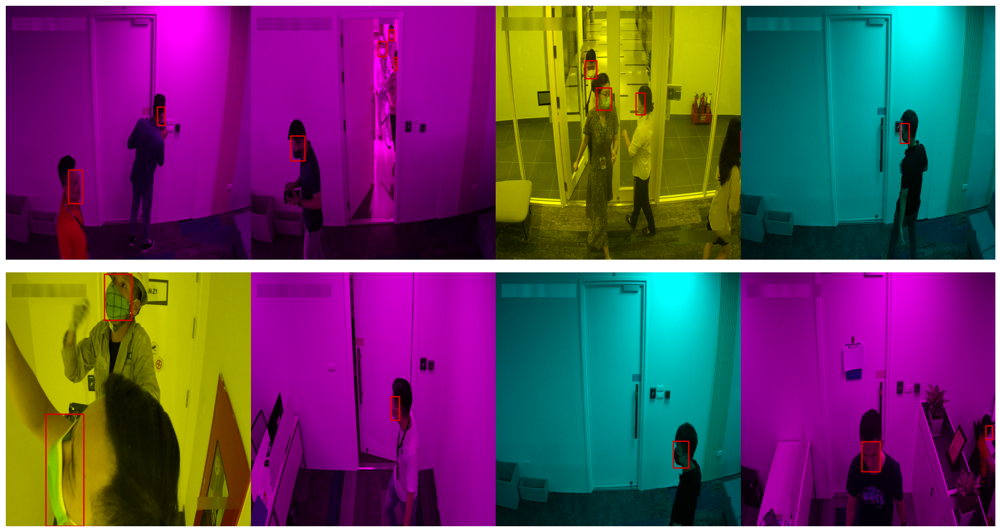

In [18]:
# Drop channel of image
def channelDropout():
  return A.Compose([
      A.augmentations.dropout.channel_dropout.ChannelDropout(channel_drop_range=(1, 1), fill_value=0, always_apply=False, p=1.0),
      A.augmentations.geometric.resize.Resize(960, 960, interpolation=1, always_apply=False, p=1.0),
  ], p=1.0, 
  # This "format" here is for coordinate of the input
  bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))


channelDropout_obj = channelDropout()
batch_size = 8
aug_visualize(df, DIR_DATA, channelDropout_obj, batch_size, 'channelDropout')

## Cutout

/home/hoang/anaconda3/envs/uavwater/lib/python3.9/site-packages/albumentations/augmentations/dropout/cutout.py:49: FutureWarning: Cutout has been deprecated. Please use CoarseDropout
  warnings.warn(


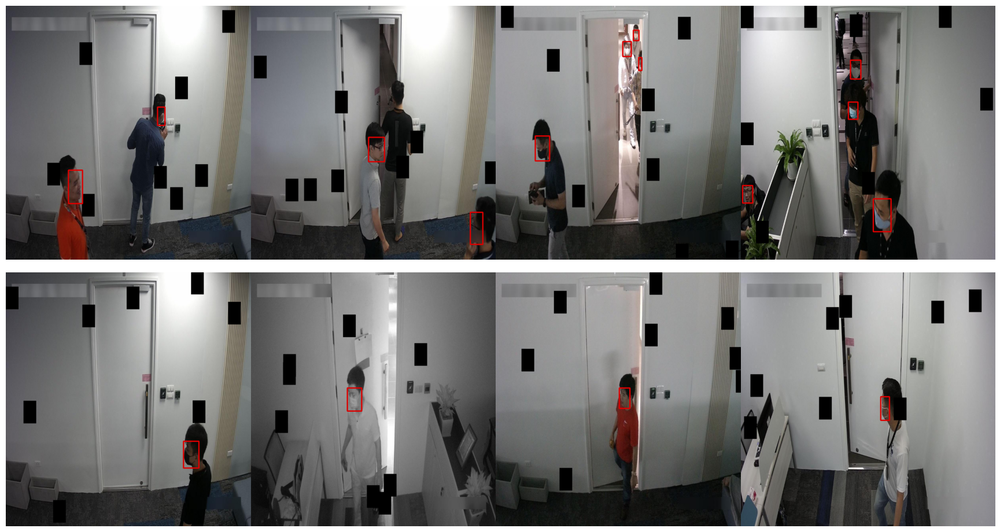

In [15]:
def cutOut():
  return A.Compose([
      A.Cutout(num_holes=8, max_h_size=64, max_w_size=64, fill_value=0, p=1.0),
      # A.augmentations.geometric.resize.Resize(720, 1280, interpolation=1, always_apply=False, p=1.0),
      A.Resize(960, 960, p=1.0),
  ], p=1.0, 
  # This "format" here is for coordinate of the input
  bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

cutOut_obj = cutOut()
batch_size = 8
aug_visualize(df, DIR_DATA, cutOut_obj, batch_size, 'cutOut')

## RandomSizedBBoxSafeCrop

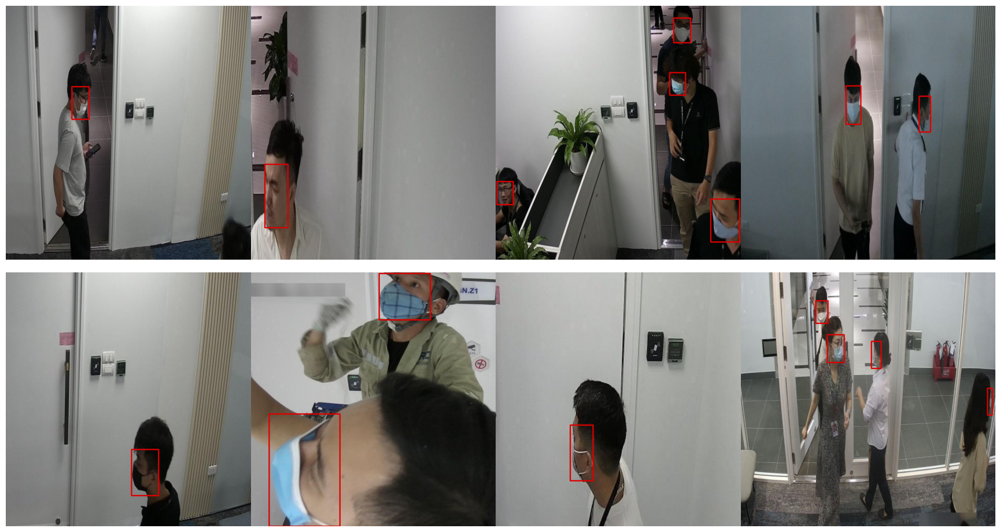

In [16]:
def RandomSizedBBoxSafeCrop():
  return A.Compose([
      A.RandomSizedBBoxSafeCrop(720, 1280, erosion_rate=0, interpolation=cv2.INTER_AREA, p=1.0),
      A.augmentations.geometric.resize.Resize(960, 960, interpolation=1, always_apply=False, p=1.0),
      # A.Resize(960, 960, p=1.0),
  ], p=1.0, 
  # This "format" here is for coordinate of the input
  bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

RandomSizedBBoxSafeCrop_obj = RandomSizedBBoxSafeCrop()
batch_size = 8
aug_visualize(df, DIR_DATA, RandomSizedBBoxSafeCrop_obj, batch_size, 'RandomSizedBBoxSafeCrop')

# Rotation

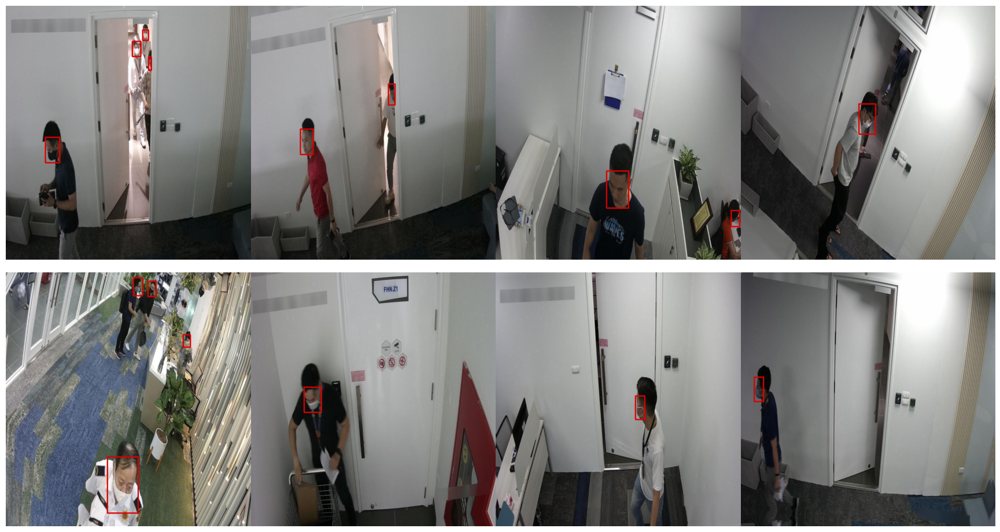

In [19]:
def Rotate():
  return A.Compose([
      A.augmentations.geometric.rotate.Rotate (limit=30, p=1.0),
      A.augmentations.geometric.resize.Resize(960, 960, interpolation=1, always_apply=False, p=1.0),
  ], p=1.0, 
  # This "format" here is for coordinate of the input
  bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

rotate_obj = Rotate()
batch_size = 8
aug_visualize(df, DIR_DATA, rotate_obj, batch_size)

## Shearing

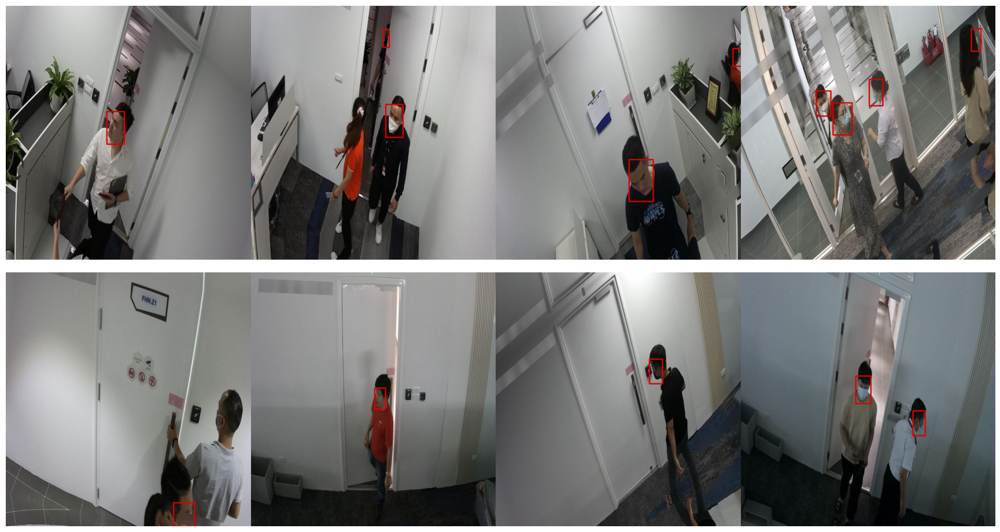

In [20]:
def Shear():
  return A.Compose([
      A.augmentations.geometric.transforms.Affine(shear=[-30,30], interpolation=1, p=1.0),
      A.augmentations.geometric.resize.Resize(720, 1280, interpolation=1, always_apply=False, p=1.0),
  ], p=1.0, 
  # This "format" here is for coordinate of the input
  bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

rotate_obj = Rotate()
batch_size = 8
aug_visualize(df, DIR_DATA, rotate_obj, batch_size)

## Equalize

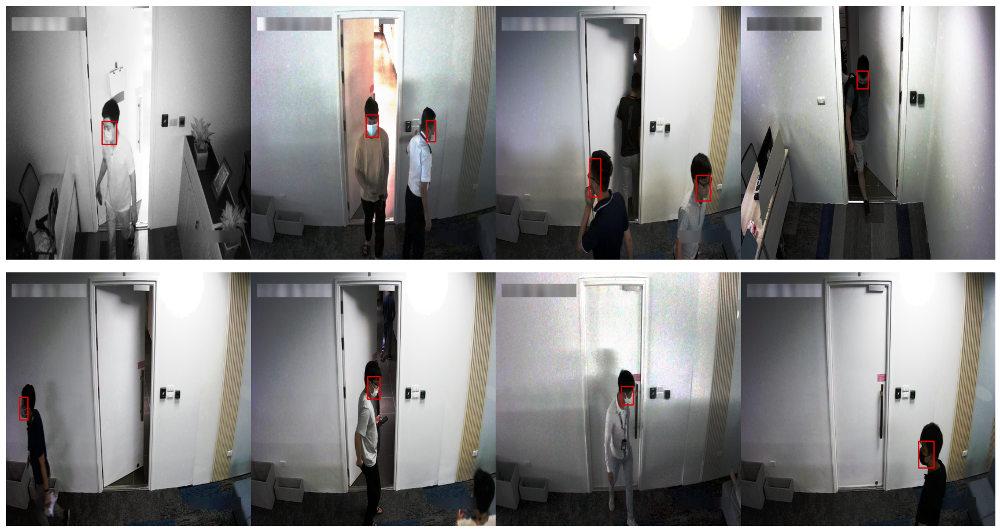

In [21]:
# Equalize the image histogram.
# Link: https://albumentations.ai/docs/api_reference/augmentations/transforms/#albumentations.augmentations.transforms.Equalize
def equalize():
  return A.Compose([
      A.augmentations.transforms.Equalize(mode='cv', by_channels=True, mask=None, mask_params=(), always_apply=False, p=1.0),
      A.augmentations.geometric.resize.Resize(960, 960, interpolation=1, always_apply=False, p=1.0),
  ], p=1.0, 
  # This "format" here is for coordinate of the input
  bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

equalize_obj = equalize()
batch_size = 8
aug_visualize(df, DIR_DATA, equalize_obj, batch_size)

## Gaussian noise

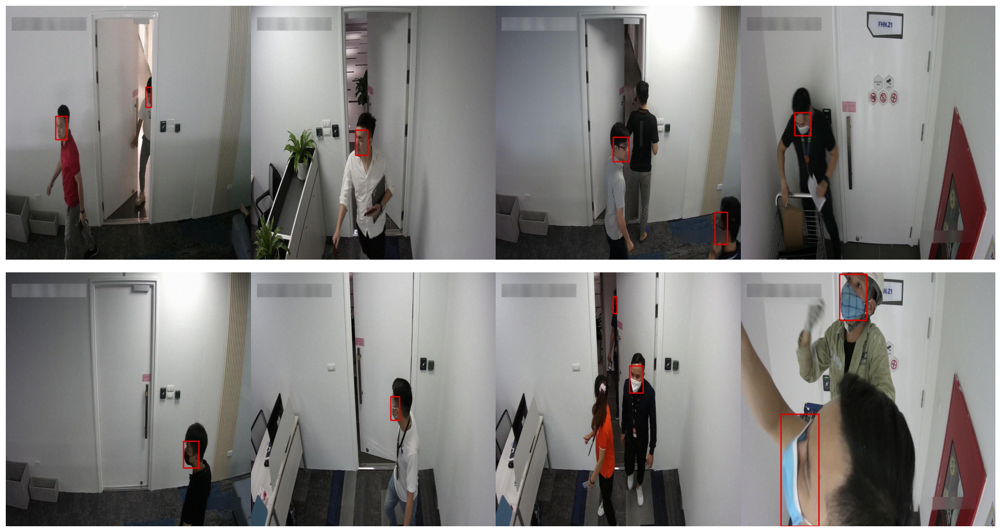

In [22]:
# Apply gaussian noise to the input image.
# Link: https://albumentations.ai/docs/api_reference/augmentations/transforms/#albumentations.augmentations.transforms.GaussNoise
def gaussNoise():
  return A.Compose([
      A.augmentations.transforms.GaussNoise (var_limit=(10.0, 50.0), mean=0, per_channel=True, always_apply=False, p=1.0),
      A.augmentations.geometric.resize.Resize(960, 960, interpolation=1, always_apply=False, p=1.0),
  ], p=1.0, 
  # This "format" here is for coordinate of the input
  bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

gaussNoise_obj = gaussNoise()
batch_size = 8
aug_visualize(df, DIR_DATA, gaussNoise_obj, batch_size)

## Random brightness contrast

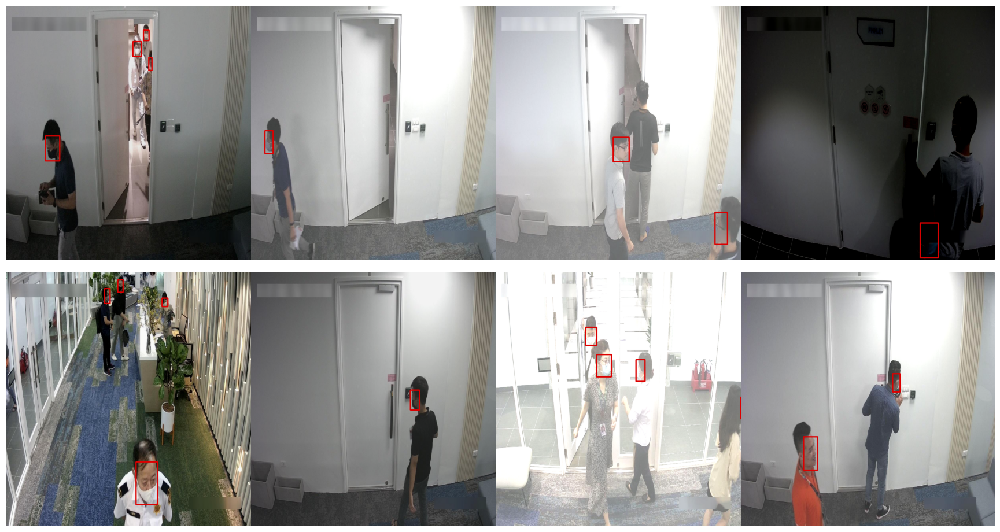

In [23]:
# Randomly change brightness and contrast of the input image.
# Link: https://albumentations.ai/docs/api_reference/augmentations/transforms/#albumentations.augmentations.transforms.RandomBrightnessContrast
def randomBrightnessContrast():
  return A.Compose([
      # A.augmentations.transforms.RandomBrightnessContrast (brightness_limit=0.1, contrast_limit=0.2, brightness_by_max=True, always_apply=False, p=1.0),
      A.RandomBrightnessContrast (brightness_limit=0.5, contrast_limit=0.2, brightness_by_max=True, always_apply=False, p=1.0),
      A.augmentations.geometric.resize.Resize(960, 960, interpolation=1, always_apply=False, p=1.0),
  ], p=1.0, 
  # This "format" here is for coordinate of the input
  bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))


randomBrightnessContrast_obj = randomBrightnessContrast()
batch_size = 8
aug_visualize(df, DIR_DATA, randomBrightnessContrast_obj, batch_size)

## Random shadow

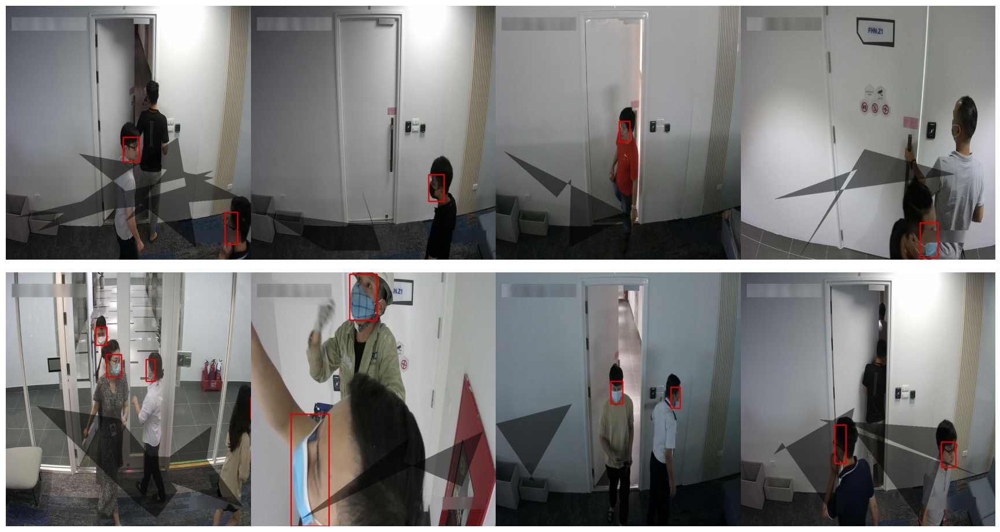

In [24]:
# Simulates shadows for the image
# Link: https://albumentations.ai/docs/api_reference/augmentations/transforms/#albumentations.augmentations.transforms.RandomShadow
def randomShadow():
  return A.Compose([
      A.augmentations.transforms.RandomShadow(shadow_roi=(0, 0.5, 1, 1), num_shadows_lower=1, num_shadows_upper=2, shadow_dimension=5, always_apply=False, p=1.0),
      A.augmentations.geometric.resize.Resize(960, 960, interpolation=1, always_apply=False, p=1.0),
  ], p=1.0, 
  # This "format" here is for coordinate of the input
  bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

randomShadow_obj = randomShadow()
batch_size = 8
aug_visualize(df, DIR_DATA, randomShadow_obj, batch_size)

## RandomToneCurve

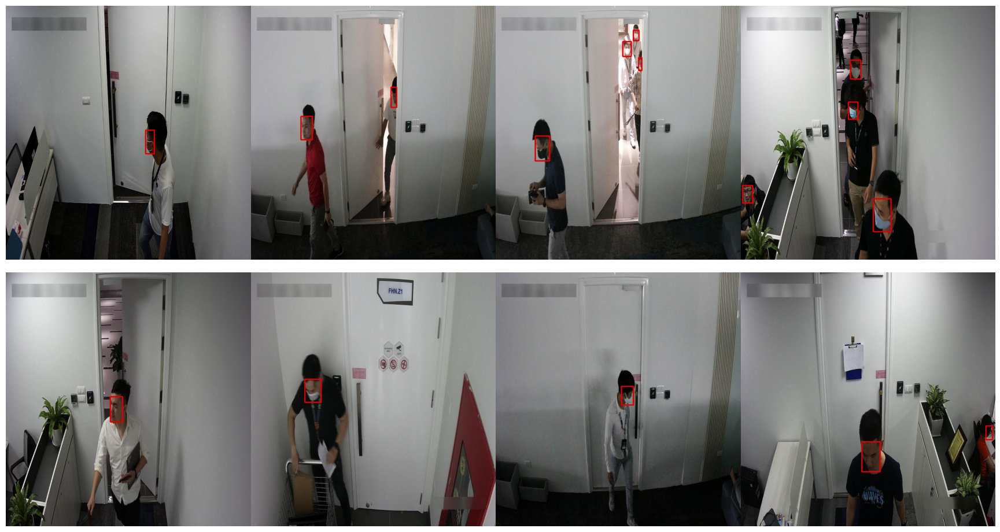

In [25]:
# Randomly change the relationship between bright and dark areas of the image by manipulating its tone curve.
# Link: https://albumentations.ai/docs/api_reference/augmentations/transforms/#albumentations.augmentations.transforms.RandomToneCurve
def RandomToneCurve():
  return A.Compose([
      A.augmentations.transforms.RandomToneCurve (scale=0.1, always_apply=True, p=1.0),
      A.augmentations.geometric.resize.Resize(960, 960, interpolation=1, always_apply=False, p=1.0),
  ], p=1.0, 
  # This "format" here is for coordinate of the input
  bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

RandomToneCurve_obj = RandomToneCurve()
batch_size = 8
aug_visualize(df, DIR_DATA, RandomToneCurve_obj, batch_size)